# Object Detection

Using pretrained models on [COCO 2017 datasets](https://cocodataset.org/#home). These [Models](https://tfhub.dev/tensorflow/collections/object_detection/1) are different from each other because of their trade-off between **Speed** and **Accuracy (mAP)**.

We'll not be fine-tuning these models, as they are already pretty good at object detection.

## Creating and loading helper modules and packages


In [1]:
import os
import pathlib

In [2]:
import io
import scipy.misc
import numpy as np
from six import BytesIO
from six.moves.urllib.request import urlopen
from PIL import Image, ImageDraw, ImageFont

In [3]:
import tensorflow as tf
import tensorflow_hub as hub

In [4]:
tf.get_logger().setLevel('ERROR')

In [62]:
def load_images_into_np_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  image = None
  if(path.startswith('http')):
    response = urlopen(path)
    image_data = response.read()
    image_data = BytesIO(image_data)
    image = Image.open(image_data)
  else:
    image_data = tf.io.gfile.GFile(path, 'rb').read()
    image = Image.open(BytesIO(image_data))

  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape((1, im_height, im_width, 3)).astype(np.uint8)

In [6]:
Models = {
    'CenterNet HourGlass104 512x512' : 'https://tfhub.dev/tensorflow/centernet/hourglass_512x512/1',
    'CenterNet HourGlass104 Keypoints 512x512' : 'https://tfhub.dev/tensorflow/centernet/hourglass_512x512_kpts/1',
    'SSD MobileNet v2 320x320' : 'https://tfhub.dev/tensorflow/ssd_mobilenet_v2/2',
}

In [7]:
COCO17_HUMAN_POSE_KEYPOINTS = [(0, 1),
 (0, 2),
 (1, 3),
 (2, 4),
 (0, 5),
 (0, 6),
 (5, 7),
 (7, 9),
 (6, 8),
 (8, 10),
 (5, 6),
 (5, 11),
 (6, 12),
 (11, 12),
 (11, 13),
 (13, 15),
 (12, 14),
 (14, 16)]

## Using Tensorflow object detection API 

Instead of creating custom functions for bounding boxes, I'll use object detection API buildin functions to visualize images with detection boxes

In [8]:
# Cloning Repo
! git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3254, done.
remote: Counting objects: 100% (3254/3254), done.
remote: Compressing objects: 100% (2558/2558), done.
remote: Total 3254 (delta 886), reused 1548 (delta 647), pack-reused 0
Receiving objects: 100% (3254/3254), 33.44 MiB | 10.48 MiB/s, done.
Resolving deltas: 100% (886/886), done.


Installing the API

In [ ]:
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

In [33]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import ops as utils_ops

%matplotlib inline

## Loading label mapping data

It is simply indexes representing string labels, will use `label_map_util` for mapping

In [34]:
PATH_TO_LABELS = './models/research/object_detection/data/mscoco_label_map.pbtxt'
category_indexes = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

### Understanding COCO-2017 Datasets

In [38]:
#
print(f" Total Categories in Coco-2017 Datasets are: {len(category_indexes)}")

 Total Categories in Coco-2017 Datasets are 80


In [153]:
total_classes = []
for i ,value in enumerate(category_indexes.values()):
  print(f"{i+1}: {value['name']}")
  total_classes.append(value['name'])


1: person
2: bicycle
3: car
4: motorcycle
5: airplane
6: bus
7: train
8: truck
9: boat
10: traffic light
11: fire hydrant
12: stop sign
13: parking meter
14: bench
15: bird
16: cat
17: dog
18: horse
19: sheep
20: cow
21: elephant
22: bear
23: zebra
24: giraffe
25: backpack
26: umbrella
27: handbag
28: tie
29: suitcase
30: frisbee
31: skis
32: snowboard
33: sports ball
34: kite
35: baseball bat
36: baseball glove
37: skateboard
38: surfboard
39: tennis racket
40: bottle
41: wine glass
42: cup
43: fork
44: knife
45: spoon
46: bowl
47: banana
48: apple
49: sandwich
50: orange
51: broccoli
52: carrot
53: hot dog
54: pizza
55: donut
56: cake
57: chair
58: couch
59: potted plant
60: bed
61: dining table
62: toilet
63: tv
64: laptop
65: mouse
66: remote
67: keyboard
68: cell phone
69: microwave
70: oven
71: toaster
72: sink
73: refrigerator
74: book
75: clock
76: vase
77: scissors
78: teddy bear
79: hair drier
80: toothbrush


## Loading Examples Images

In [175]:
IMAGES_FOR_TEST = {
    'park':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detection_example_00.jpg',
    'kitchen':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detection_example_01.jpg',
    'kitchen01':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detection_example_02.jpg',
    'street':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detection_example_03.jpg',
    'people':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detection_example_04.jpg',
    'zoo':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detection_example_05.jpg',
    'street01':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detection_example_06.jpg',
    'room1':'https://raw.githubusercontent.com/ozzmanmuhammad/Object-Detection/main/Images/object_detetcion_example_07.jpg',
    'beach' : 'models/research/object_detection/test_images/image2.jpg'
}

In [84]:
image = "park" 
image_path = IMAGES_FOR_TEST[image]
image = load_images_into_np_array(image_path)

In [85]:
image.shape

(1, 1296, 1920, 3)

In [ ]:
image[0] # only image

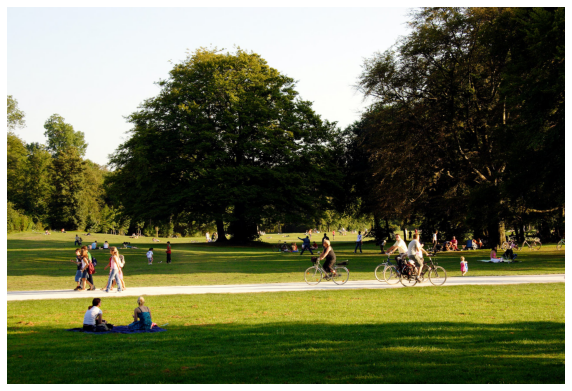

In [79]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,7))
plt.imshow(image[0])
plt.axis(False);

## Loading Detection Model with pretrained Weights

For this experiment I'll use `CenterNet HourGlass104 Keypoints 512x512` model which has also keypoints. We can also use segmentation based models. [CenterNet Paper Link](https://paperswithcode.com/paper/centernet-object-detection-with-keypoint)

For tensorflow JS or to use model on I'll use small and lite model: `SSD MobileNet v2 320x320`, which has less accuracy then CenterNet but much faster.

In [46]:
model_name = 'CenterNet HourGlass104 Keypoints 512x512'
model_URL = Models[model_name]

print(f"Model name: {model_name},\ntf.hub URL: {model_URL}")

Model name: CenterNet HourGlass104 Keypoints 512x512,
tf.hub URL: https://tfhub.dev/tensorflow/centernet/hourglass_512x512_kpts/1


In [ ]:
# Loading model from tensorflow hub
model = hub.load(model_URL)

In [ ]:
# another way for highlevel keras framework
# model2 = hub.KerasLayer(model_URL)

### Making Inference / Prediction

In [87]:
# Predicting on example image
preds = model(image)

Returns dict so we can easily iterate

In [94]:
results = {key:value.numpy() for key, value in preds.items()}

In [98]:
print(f"Model returns:")
for key in results.keys():
  print(f"--> {key}")

Model returns:
--> detection_classes
--> detection_keypoint_scores
--> detection_boxes
--> num_detections
--> detection_keypoints
--> detection_scores


In [ ]:
pred_classes=[]
for num, pred_ids in enumerate(np.nditer(results["detection_classes"])):
    print(f"{num+1}--> Prediction class : {category_indexes[np.round(pred_ids)]['name']}")
    pred_classes.append(category_indexes[np.round(pred_ids)]['name'])

In [145]:
# Total predictions per class

preds_per_class = dict().fromkeys(pred_classes, 0)
for preds in np.nditer(results["detection_classes"]):
    Class = category_indexes[np.round(preds)]['name']
    preds_per_class[Class] = preds_per_class[Class] + 1

preds_per_class

{'backpack': 12,
 'bench': 11,
 'bicycle': 13,
 'boat': 2,
 'chair': 4,
 'fire hydrant': 1,
 'frisbee': 1,
 'handbag': 11,
 'person': 38,
 'sports ball': 3,
 'tennis racket': 4}

In [146]:
sum(preds_per_class.values())

100

In [160]:
results["num_detections"].astype(np.int16)[0]

100

### Visualizing the predictions

We can create custom function to draw boxes using x, y, width and height, But will use object detection api `viz_utils.visualize_boxes_and_labels_on_image_array()` function.

This function is very usefull because


1.   We can set the total number of boxes.
2.   We can set the cutoff score threshold.
3.   



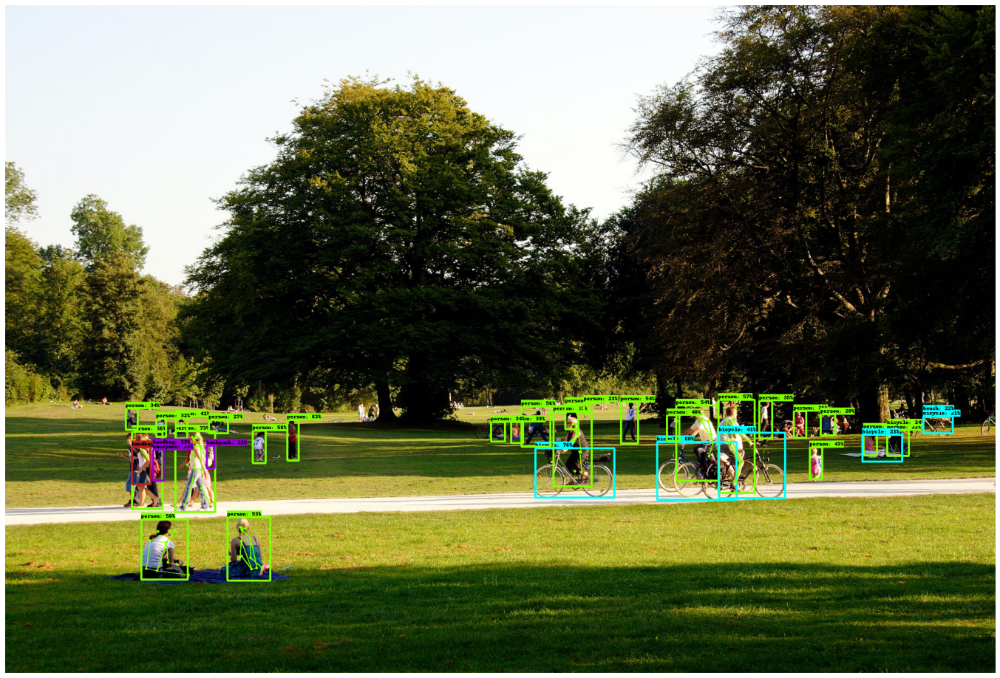

In [152]:
label_id_offset = 0
image_with_detections = image.copy()

# Use keypoints if available in detections
keypoints, keypoint_scores = None, None
if 'detection_keypoints' in results:
  keypoints = results['detection_keypoints'][0]
  keypoint_scores = results['detection_keypoint_scores'][0]

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_with_detections[0],
      results['detection_boxes'][0],
      (results['detection_classes'][0] + label_id_offset).astype(int),
      results['detection_scores'][0],
      category_indexes,
      use_normalized_coordinates=True,
      max_boxes_to_draw=100,
      min_score_thresh=.20,
      agnostic_mode=False,
      keypoints=keypoints,
      keypoint_scores=keypoint_scores,
      keypoint_edges=COCO17_HUMAN_POSE_KEYPOINTS)

plt.figure(figsize=(24,32))
plt.imshow(image_with_detections[0])
plt.axis(False)
plt.show()

In [156]:
"tree" in total_classes

False

In [176]:
!mkdir predictions

In [177]:
# Creating function to load, predict and draw image
def load_predict_draw_images(image_name, model = model, min_score_thresh=.20):
  image = image_name 
  image_path = IMAGES_FOR_TEST[image]
  image = load_images_into_np_array(image_path)

  # Predicting on example image
  preds = model(image)

  # Getting results
  results = {key:value.numpy() for key, value in preds.items()}

  # Drawing boxes and images
  label_id_offset = 0
  image_with_detections = image.copy()

  # Use keypoints if available in detections
  keypoints, keypoint_scores = None, None
  if 'detection_keypoints' in results:
    keypoints = results['detection_keypoints'][0]
    keypoint_scores = results['detection_keypoint_scores'][0]

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_with_detections[0],
        results['detection_boxes'][0],
        (results['detection_classes'][0] + label_id_offset).astype(int),
        results['detection_scores'][0],
        category_indexes,
        use_normalized_coordinates=True,

        max_boxes_to_draw = results["num_detections"].astype(np.int16)[0],
        min_score_thresh=.20,

        agnostic_mode=False,
        keypoints=keypoints,
        keypoint_scores=keypoint_scores,
        keypoint_edges=COCO17_HUMAN_POSE_KEYPOINTS)

  plt.figure(figsize=(24,32))
  plt.imshow(image_with_detections[0])
  plt.axis(False)
  plt.savefig("/content/predictions/"+image_name+"_predictions", format="jpg")
  plt.show()




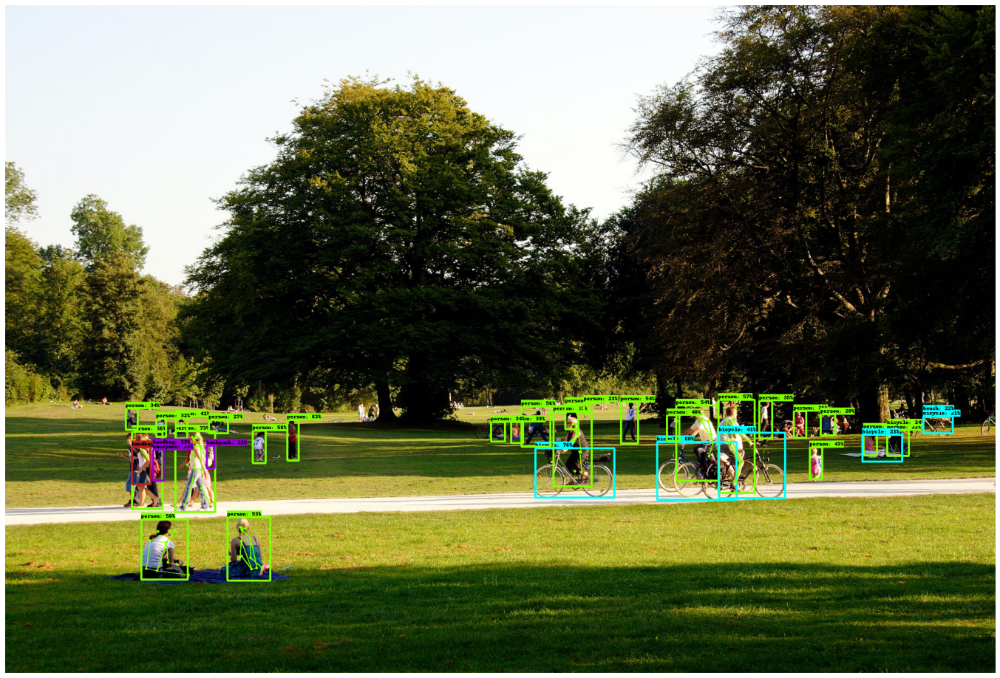

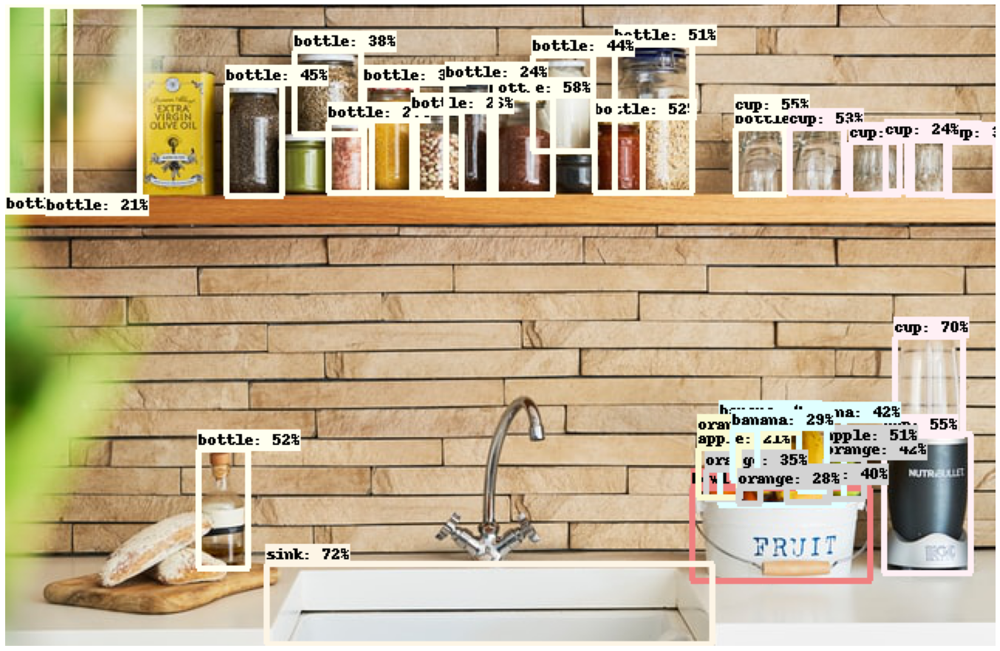

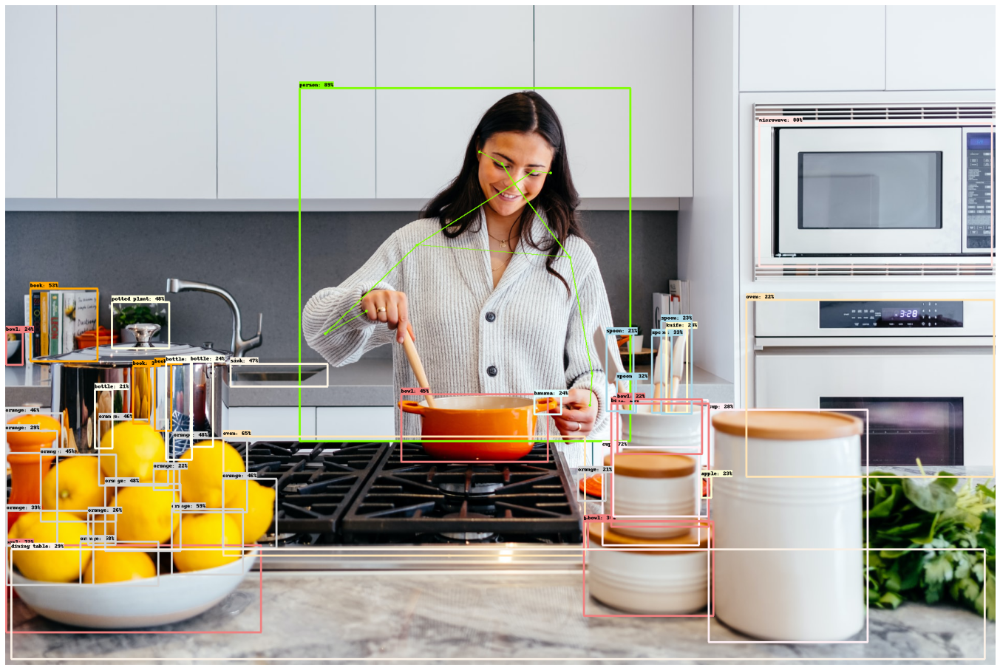

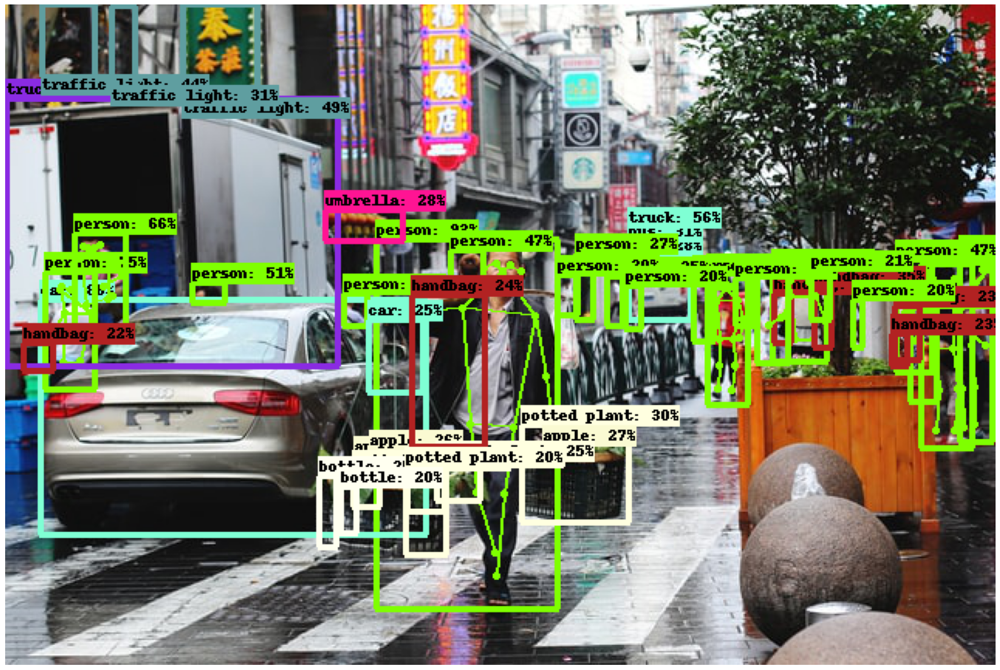

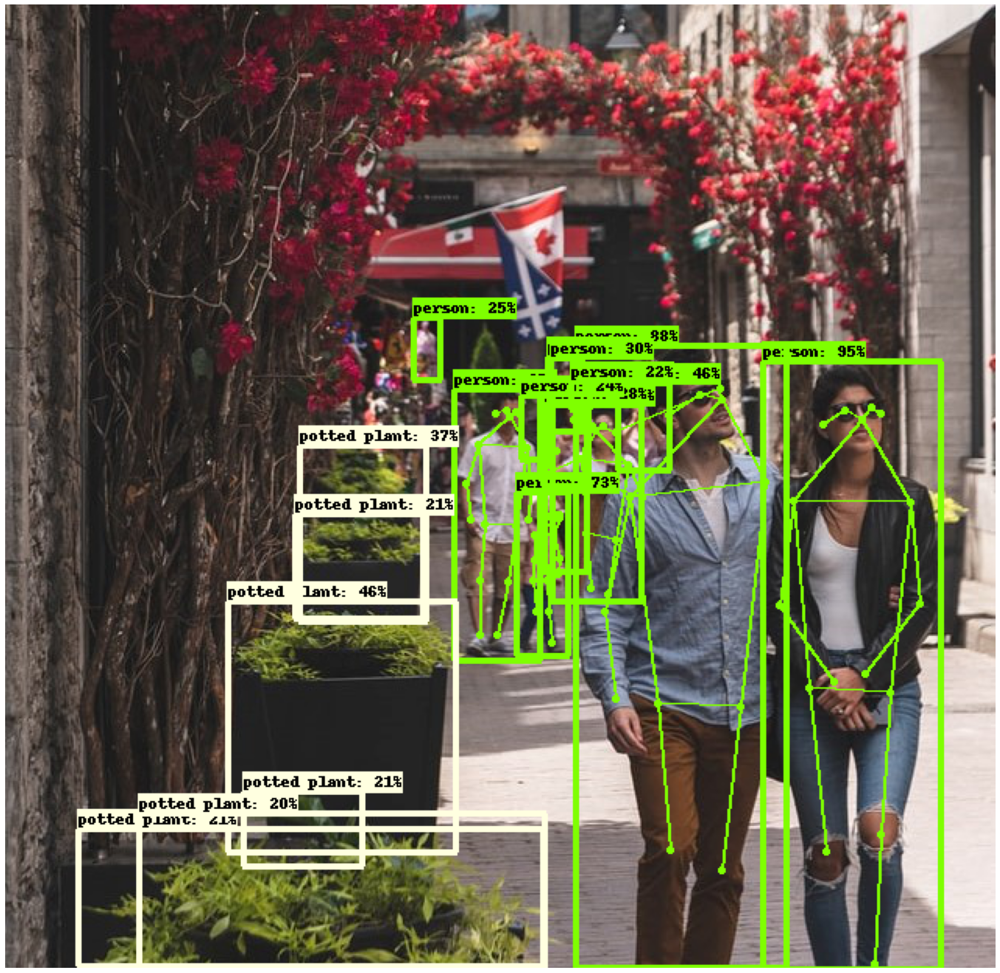

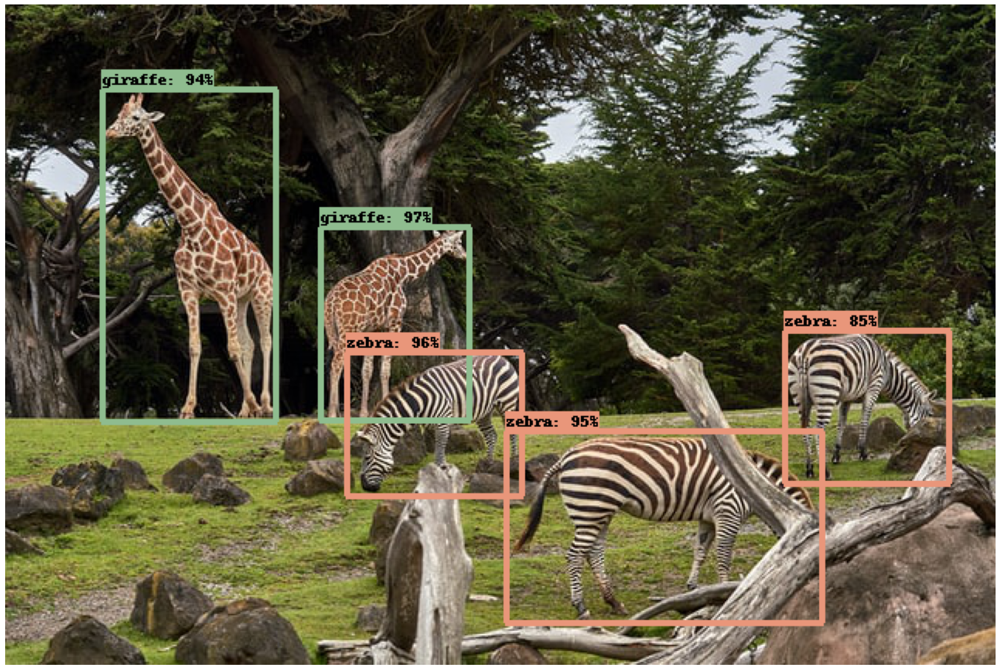

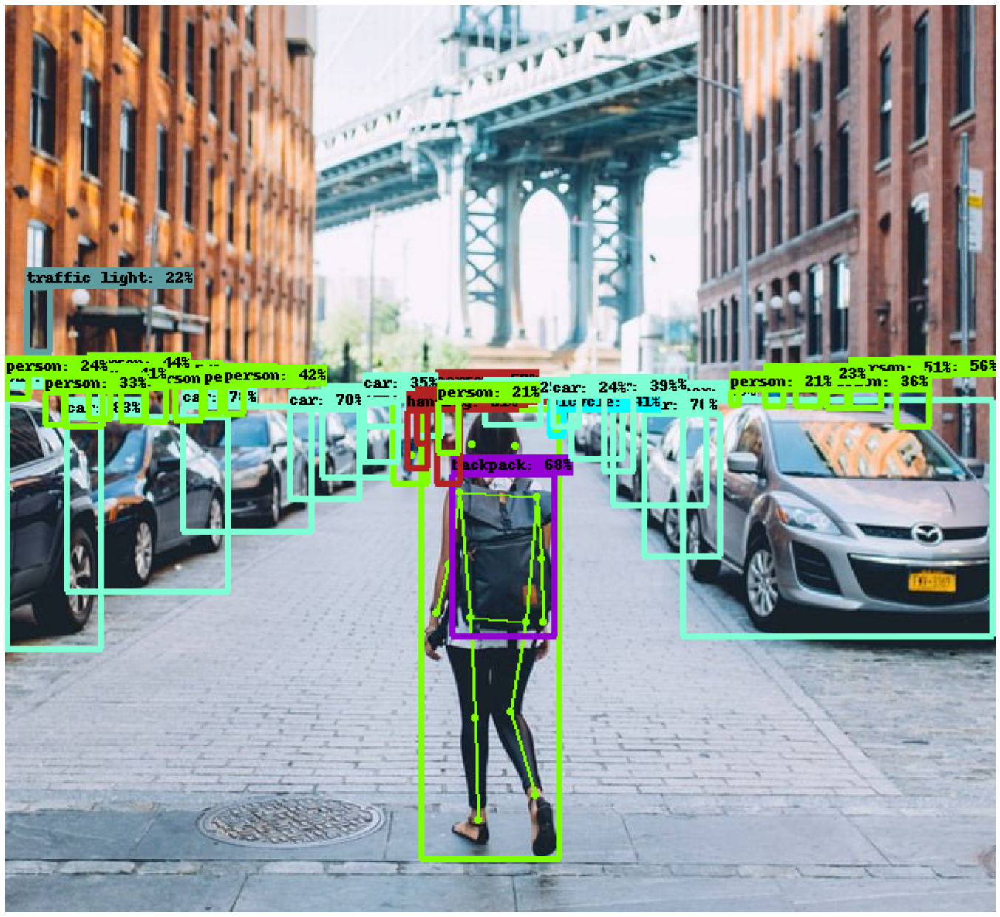

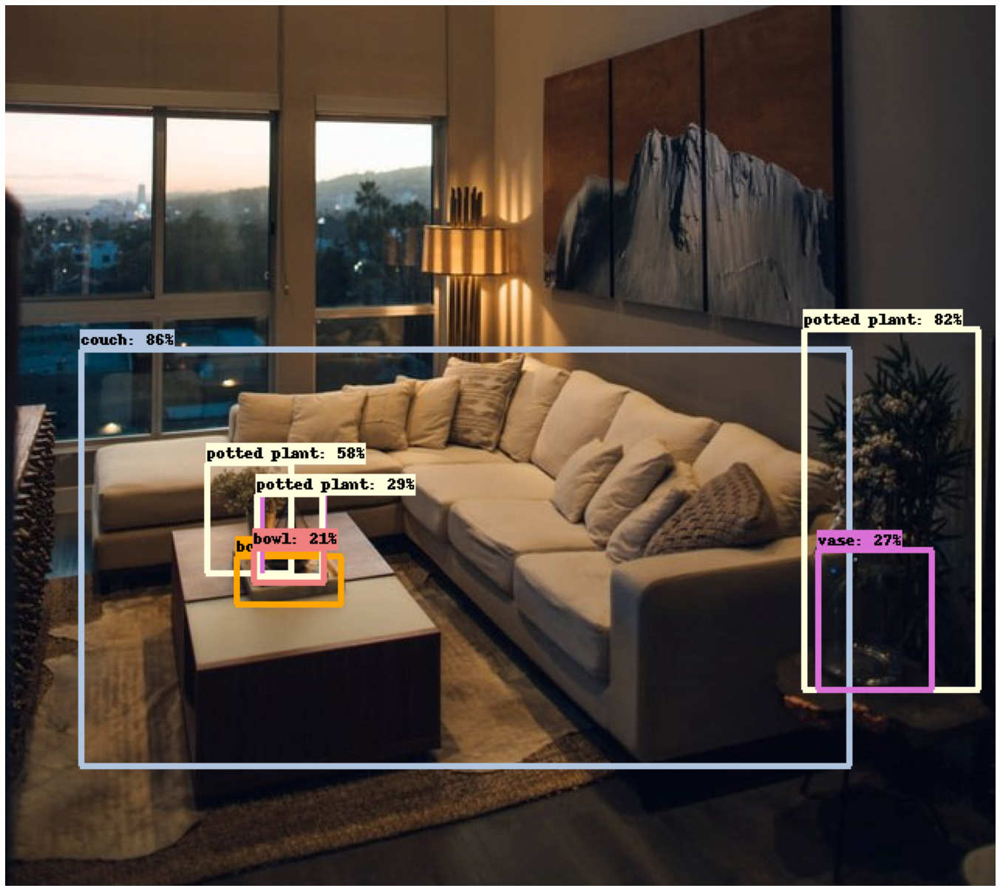

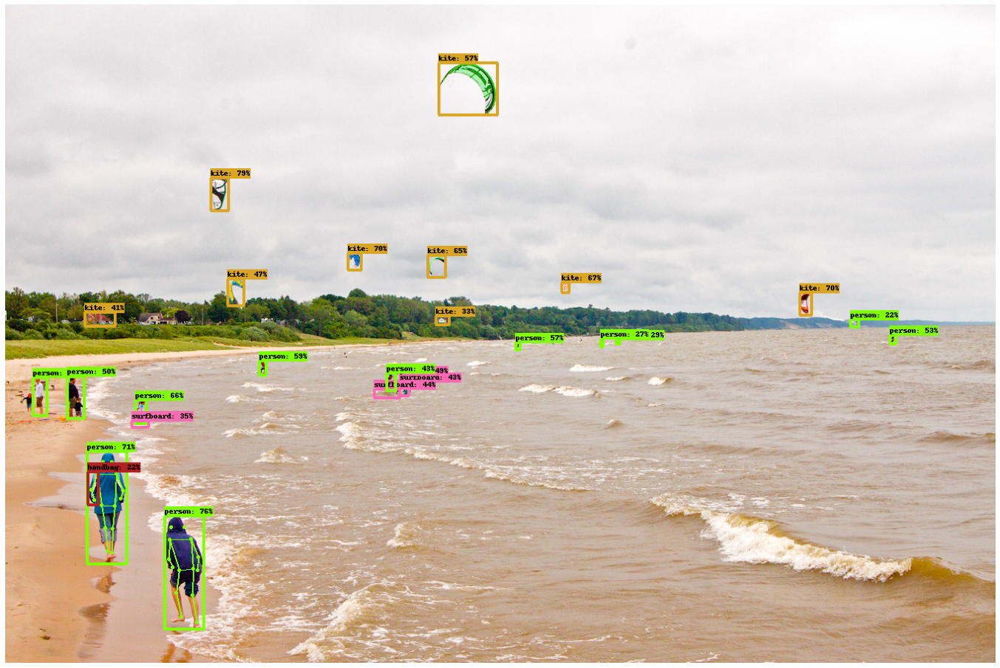

In [178]:
for image_path in IMAGES_FOR_TEST.keys():
  load_predict_draw_images(
      image_name = image_path, 
      model = model, 
      min_score_thresh=.30
  )

In [ ]:
from google.colab import files
files.download("/content/predictions/")

For Real-time prediction, I'll use small mobileNet model and will use ml5, p5 JS packages